<a href="https://colab.research.google.com/github/ich-20211101/appliedMultivariateStatisticalAnalysis/blob/main/5_SVM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [9]:
import numpy as np
from sklearn.linear_model import LogisticRegression, LinearRegression
import matplotlib.pyplot as plt

In [10]:
# set larger font sizes and the style
import matplotlib as mpl
font_size = 24
mpl.rcParams.update({'font.size': font_size})
mpl.rcParams['xtick.labelsize'] = font_size-5
mpl.rcParams['ytick.labelsize'] = font_size-5
plt.style.use('bmh')

In [11]:
# LARGE DOGS AND SMALL HORSES - SET DISTRIBUTION PARAMETERS
# MAY OR MAY NOT CORRESPOND TO ACTUAL EARTH MAMMAL DIMENSIONS

number_of_observations = 100 # per class
dog_weight_mean = 80
dog_weight_stddev = 10
dog_height_mean = 20
dog_height_stddev = 10
horse_weight_mean = 90
horse_weight_stddev = 10
horse_height_mean = 30
horse_height_stddev = 10

In [12]:
# GENERATE SAMPLE OBSERVATIONS
np.random.seed(42)
dog_weights = np.random.normal(dog_weight_mean,
                               dog_weight_stddev,
                               number_of_observations)
dog_heights = np.random.normal(dog_height_mean,
                               dog_height_stddev,
                               number_of_observations)
dog_targets = [0]*number_of_observations # dogs are 0

horse_weights = np.random.normal(horse_weight_mean,
                                 horse_weight_stddev,
                                 number_of_observations).clip(80)
horse_heights = np.random.normal(horse_height_mean,
                                 horse_height_stddev,
                                 number_of_observations)
horse_targets = [1]*number_of_observations # horses are 1

# combine data sets
weights = np.hstack((dog_weights, horse_weights))
heights = np.hstack((dog_heights, horse_heights))

X = np.vstack((weights, heights)).T.clip(min=1)
y = np.hstack((dog_targets,horse_targets))

# separate arrays for plotting later
X_horses = X[y == 1]
y_horses = y[y == 1]

X_dogs = X[y == 0]
y_dogs = y[y == 0]

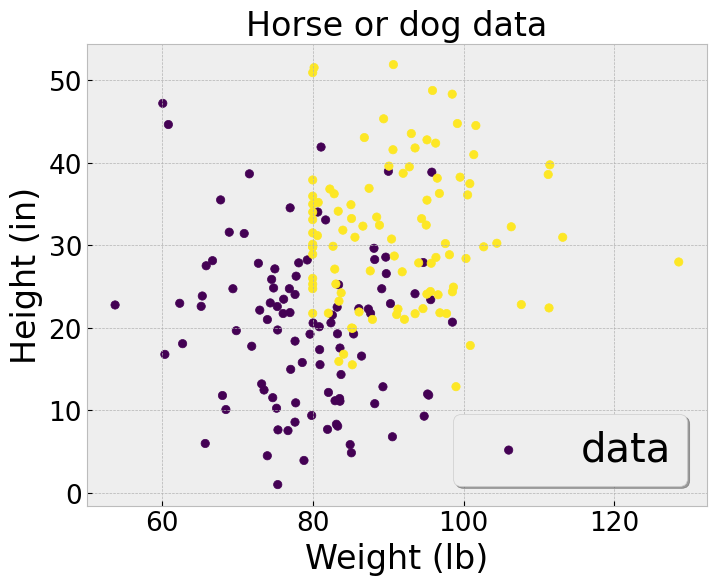

In [13]:
fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111)
ax.scatter(X[:,0], X[:,1], c=y, label='data')
ax.legend(shadow=True, fontsize='large')
ax.set_xlabel('Weight (lb)',fontsize=font_size)
ax.set_ylabel('Height (in)',fontsize=font_size)
ax.set_title('Horse or dog data',fontsize=font_size)
plt.show()

In [14]:
import plotly.graph_objects as go

In [15]:
y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1])

In [16]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [17]:
log_model_w = LogisticRegression()
log = log_model_w.fit(X_train,y_train)

In [18]:
pred_train = log.predict(X_train)

In [19]:
from sklearn.metrics import accuracy_score
Accuracy_training = accuracy_score(y_train, pred_train)

In [20]:
Accuracy_training

0.8208955223880597

In [21]:
pred = log.predict(X_test)  # 예측 먼저 수행
Accuracy_test = accuracy_score(y_test, pred)  # 정확도 계산

In [22]:
Accuracy_test

0.8333333333333334

In [23]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [24]:
confusion_matrix(y_test, pred)

array([[29,  6],
       [ 5, 26]])

In [25]:
from sklearn.metrics import classification_report

print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.85      0.83      0.84        35
           1       0.81      0.84      0.83        31

    accuracy                           0.83        66
   macro avg       0.83      0.83      0.83        66
weighted avg       0.83      0.83      0.83        66



In [26]:
#Accuracy , F1-score
print((84+80)/(84+16+20+80))

0.82


In [27]:
P = (84/(84+16))
R = (84/(84+20))
F1 = 2*P*R/(P+R)
F1

0.8235294117647058

In [28]:
log_model_w = LogisticRegression()
log_model_w.fit(X,y)

x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                     np.arange(y_min, y_max, 0.1))
Z = log_model_w.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,1]
Z = Z.reshape(xx.shape)

scatter = go.Scatter3d(
    x=X[:, 0],
    y=X[:, 1],
    z=y,
    mode='markers',
    marker=dict(
        size=5,
        color=y,
        colorscale='Rainbow',
        opacity=0.8
    )
)

# Create 3D surface visualization using Plotly
surface = go.Surface(x=xx, y=yy, z=Z, colorscale='Viridis', opacity=0.6)

# Create figure and add scatter plot and surface
fig = go.Figure(data=[scatter, surface])
fig.update_layout(
    title='Logistic Regression',
    scene=dict(
            xaxis_title='Weight',
            yaxis_title='Height',
            zaxis_title='Probability',
    )
)
fig.show()

In [29]:
from sklearn.svm import SVC

svc = SVC(kernel = 'poly' , degree = 10)
svc_l = svc.fit(X_train, y_train)
pred = svc_l.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[31  4]
 [ 7 24]]
              precision    recall  f1-score   support

           0       0.82      0.89      0.85        35
           1       0.86      0.77      0.81        31

    accuracy                           0.83        66
   macro avg       0.84      0.83      0.83        66
weighted avg       0.84      0.83      0.83        66



In [30]:
prediction_training = svc_l.predict(X_train)
accuracy_training_SVC = accuracy_score(y_train,prediction_training)

In [31]:
accuracy_training_SVC

0.7910447761194029

In [32]:
accuracy_test_SVC = accuracy_score(y_test,pred)

In [33]:
accuracy_test_SVC

0.8333333333333334

In [34]:
print((82+81)/(82+81+18+19))

0.815


In [35]:
from sklearn.svm import SVC

svc = SVC(kernel = 'poly' , degree = 10)
svc.fit(X, y)

# Generate grid for 3D visualization
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                     np.arange(y_min, y_max, 0.1))
Z = svc.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

scatter = go.Scatter3d(
    x=X[:, 0],
    y=X[:, 1],
    z=y,
    mode='markers',
    marker=dict(
        size=5,
        color=y,
        colorscale='Rainbow',
        opacity=0.8
    )
)

# Create 3D surface visualization using Plotly
surface = go.Surface(x=xx, y=yy, z=Z, colorscale='Viridis', opacity=0.6)

# Create figure and add scatter plot and surface
fig = go.Figure(data=[scatter, surface])
fig.update_layout(
    title='Support Vector Machine Horse Example',
    scene=dict(
            xaxis_title='Weight',
            yaxis_title='Height',
            zaxis_title='Probability',
    )
)
fig.show()

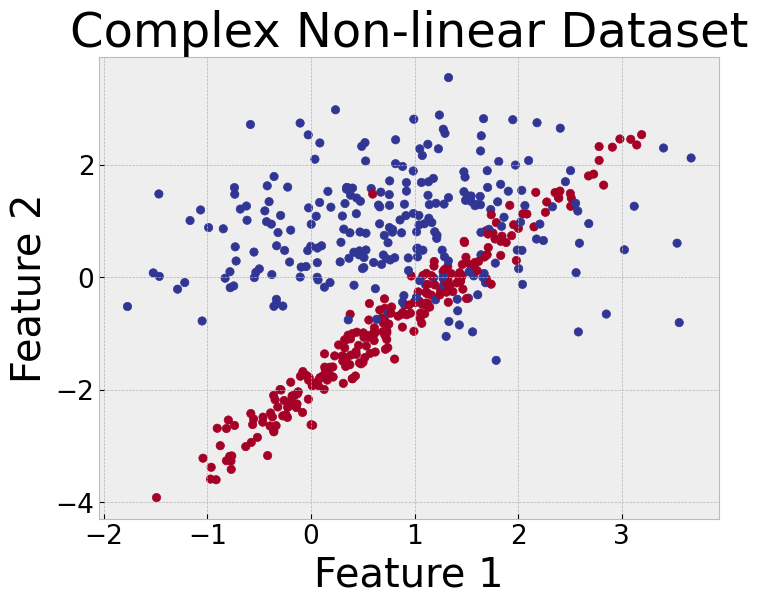

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification

# Generate complex non-linear dataset
X, y = make_classification(
    n_samples=500,
    n_features=2,
    n_informative=2,
    n_redundant=0,
    n_clusters_per_class=1,
    class_sep=0.8,
    random_state=0
)

# Plot the dataset
plt.figure(figsize=(8, 6))
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.RdYlBu)
plt.title('Complex Non-linear Dataset')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

In [37]:
log_model_w = LogisticRegression()
log_model_w.fit(X,y)

LogisticRegression()

In [38]:

log_model_w = LogisticRegression()
log_model_w.fit(X,y)
# Generate grid for 3D visualization
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                     np.arange(y_min, y_max, 0.1))
Z = log_model_w.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,1]
Z = Z.reshape(xx.shape)

scatter = go.Scatter3d(
    x=X[:, 0],
    y=X[:, 1],
    z=y,
    mode='markers',
    marker=dict(
        size=5,
        color=y,
        colorscale='Rainbow',
        opacity=0.8
    )
)

# Create 3D surface visualization using Plotly
surface = go.Surface(x=xx, y=yy, z=Z, colorscale='Viridis', opacity=0.6)

# Create figure and add scatter plot and surface
fig = go.Figure(data=[scatter, surface])
fig.update_layout(
    title='Logistic Regression 3D',
    scene=dict(
            xaxis_title='Feature 1',
            yaxis_title='Feature 2',
            zaxis_title='Probability',
    )
)
fig.show()

In [43]:
svc = SVC(C =0.1, kernel='poly', degree = 1)
svc_l = svc.fit(X_train, y_train)
pred = svc_l.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[28  7]
 [ 4 27]]
              precision    recall  f1-score   support

           0       0.88      0.80      0.84        35
           1       0.79      0.87      0.83        31

    accuracy                           0.83        66
   macro avg       0.83      0.84      0.83        66
weighted avg       0.84      0.83      0.83        66



In [39]:
SVC = SVC(kernel='rbf')
SVC = SVC.fit(X, y)
pred = SVC.predict(X)
print(confusion_matrix(y, pred))
print(classification_report(y, pred))